# 1. Exploración y perfilamiento del conjunto de datos

En este apartado se importan las librerías necesarias para la lectura, exploración y análisis del dataset, así como para la posterior construcción del modelo.

In [1]:
#Importar librerías
import pandas as pd
#!pip install ydata-profiling
from ydata_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.model_selection import train_test_split, KFold, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, RobustScaler
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
from sklearn.metrics import roc_curve, roc_auc_score, precision_recall_curve, average_precision_score, classification_report

Se procede a cargar el dataset y eliminar la columna *Unnamed: 0*, la cual no aporta información relevante y no formaba parte del dataset original.

In [2]:
#Carga el dataset
df = pd.read_csv("data_train.csv", delimiter=",")
df = df.drop('Unnamed: 0', axis=1)
df.head()

,age,sex,dzgroup,dzclass,num.co,scoma,avtisst,race,sps,aps,...,dnr,dnrday,meanbp,hrt,resp,temp,crea,sod,adlsc,hospdead
0,62.84998,male,Lung Cancer,Cancer,0,0.0,7.000000,other,33.898438,20.0,...,no dnr,5.0,97.0,69.0,22.0,36.00000,1.199951,141.0,7.0,0
1,60.33899,female,Cirrhosis,COPD/CHF/Cirrhosis,2,44.0,29.000000,white,52.695312,74.0,...,NaN,NaN,43.0,112.0,34.0,34.59375,5.500000,132.0,1.0,1
2,52.74698,female,Cirrhosis,COPD/CHF/Cirrhosis,2,0.0,13.000000,white,20.500000,45.0,...,no dnr,17.0,70.0,88.0,28.0,37.39844,2.000000,134.0,0.0,0
3,42.38498,female,Lung Cancer,Cancer,2,0.0,7.000000,white,20.097656,19.0,...,no dnr,3.0,75.0,88.0,32.0,35.00000,0.799927,139.0,0.0,0
4,79.88495,female,ARF/MOSF w/Sepsis,ARF/MOSF,1,26.0,18.666656,white,23.500000,30.0,...,no dnr,16.0,59.0,112.0,20.0,37.89844,0.799927,143.0,2.0,0


El diccionario del dataset es el siguiente:

* `age:` Edad del paciente en años.
* `sex:` Género del paciente.
* `dzclass:` Categoría de enfermedad.
* `dzgroup:` Subcategoría de enfermedad del paciente.
* `num.co:` Número de comorbilidades simultáneas. Valores mayores indican peor condición y menor probabilidad de supervivencia.
* `scoma`: puntaje de coma medido en el día 3 dentro del estudio SUPPORT basado en escala de Glasgow.
* `avtisst`: Puntaje TISS (Therapeutic Intervention Scoring System) días 3–25 en UCI o IMCU.
* `race`: Raza del paciente.
* `sps:` Puntaje fisiológico SUPPORT en el día 3.
* `aps:` Puntaje fisiológico APACHE III en el día 3.
* `surv2m:` Estimación de supervivencia a 2 meses.
* `surv6m:` Estimación de supervivencia a 6 meses.
* `hday:` Día de hospital en que ingresó al estudio.
* `diabetes:` Indica si presenta diabetes como comorbilidad.
* `dementia:` Indica si presenta demencia como comorbilidad.
* `ca:` Indica si el paciente tiene cáncer.
* `dnr:` Orden de no resucitar.
* `dnrday:` Día de la orden DNR.
* `meanbp:` Presión arterial media día 3.
* `hrt:` Frecuencia cardiaca día 3.
* `resp:` Frecuencia respiratoria día 3.
* `temp:` Temperatura en °C día 3.
* `crea:` Creatinina sérica día 3.
* `sod:` Sodio sérico día 3.
* `adlsc:` ADL imputado/calibrado al sustituto.
* `hospdead:` Muerte en hospital.






El dataset cuenta con 9.105 registros y 26 variables, de las cuales una corresponde a la variable objetivo: `hospdead`. Adicionalmente, se identifican 8 variables categóricas y la variable objetivo es de tipo binaria (categórica), donde el valor 0 indica que no ocurrió la muerte en hospital y el valor 1 indica que sí ocurrió.

In [3]:
df.shape

(9105, 26)

In [4]:
df.dtypes

,0
age,float64
sex,object
dzgroup,object
dzclass,object
num.co,int64
scoma,float64
avtisst,float64
race,object
sps,float64
aps,float64


En esta etapa inicial se observa que el dataset presenta un total de 261 valores nulos distribuidos en distintas variables.

In [5]:
df.isnull().sum()

,0
age,0
sex,0
dzgroup,0
dzclass,0
num.co,0
scoma,1
avtisst,82
race,42
sps,1
aps,1


A continuación, se realizará un análisis exploratorio de datos más exhaustivo utilizando la librería `ydata-profiling`, con el fin de obtener un panorama detallado de la calidad, distribución y relaciones entre las variables del dataset.

In [6]:
#EDA
profile = ProfileReport(df, explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 26/26 [00:01<00:00, 23.36it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

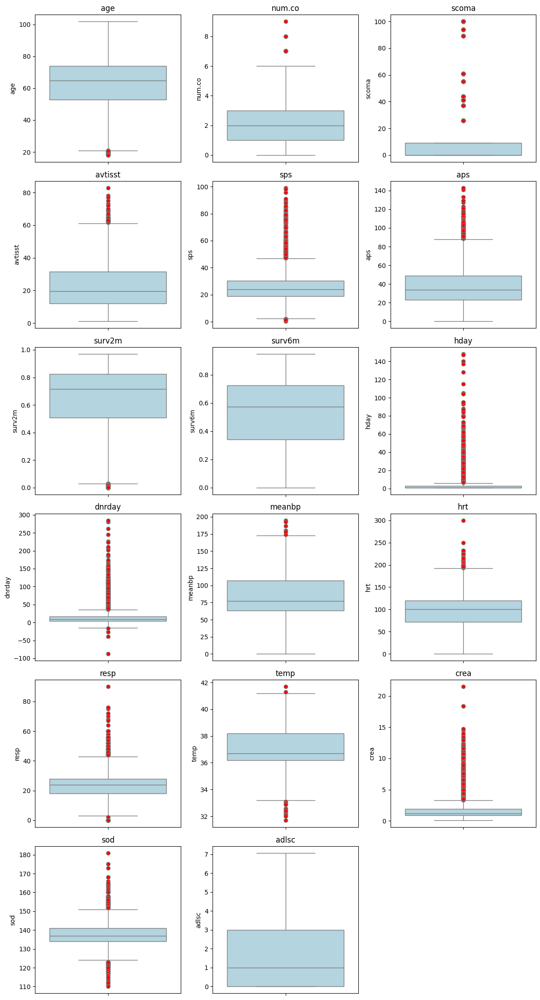

In [7]:
%matplotlib inline

#Variables numéricas
num_var = ["age","num.co","scoma","avtisst","sps","aps","surv2m","surv6m","hday","dnrday","meanbp","hrt","resp","temp","crea","sod","adlsc"]
#Variables categóricas
cat_var = ["sex","dzgroup","dzclass","race","diabetes","dementia","ca","dnr"]
#Columnas numéricas
df_num = df[num_var].copy()

# Definir tamaño adecuado para la cuadrícula (mínimo de filas necesarias)
rows = (len(df_num.columns) // 3) + (1 if len(df_num.columns) % 3 else 0)
cols = min(3, len(df_num.columns))

# Configurar la figura y los subgráficos de forma dinámica
fig, axes = plt.subplots(rows, cols, figsize=(12, 4 * rows))

# Asegurar que `axes` sea iterable, independientemente de la forma de la cuadrícula
axes = np.array(axes).reshape(-1)

# Dibujar los boxplots
for i, col in enumerate(df_num.columns):
    sns.boxplot(y=df_num[col], ax=axes[i], color='lightblue', flierprops={'marker': 'o', 'markerfacecolor': 'red'})
    axes[i].set_title(col)

# Ocultar ejes vacíos si hay menos gráficos que espacios
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar el espacio entre los gráficos
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()



El análisis exploratorio permitió identificar las principales características y particularidades del conjunto de datos. A partir de los diagramas de caja se evidenció la presencia de múltiples outliers en variables clínicas como `scoma`, `avtisst`, `sps`, `aps`, `hday`, `hrt`, `resp`, `crea`, `sod` y `dnrday`, lo cual confirma la necesidad de aplicar técnicas de escalamiento robusto que reduzcan el impacto de valores extremos en el modelo. Asimismo, la matriz de correlación mostró que las variables presentan en general correlaciones bajas o moderadas, sin evidenciar multicolinealidad severa, aunque algunas relaciones puntuales deberán considerarse al momento de la reducción de dimensionalidad.

En cuanto a las variables categóricas, será necesario transformarlas en dummies para que puedan ser procesadas por el modelo SVM, el cual trabaja únicamente con entradas numéricas. Finalmente, dado que el dataset contiene un número considerable de variables, se aplicará PCA (Análisis de Componentes Principales) como estrategia de reducción de dimensionalidad, buscando disminuir la complejidad del espacio de características y mejorar el desempeño computacional sin sacrificar demasiada información.

Con base en lo anterior, los pasos siguientes estarán orientados a la preparación de los datos mediante codificación de variables categóricas, escalamiento robusto y reducción de dimensionalidad, para posteriormente entrenar un modelo SVM con optimización de hiperparámetros, aprovechando estas transformaciones para mitigar los efectos de los outliers y manejar de forma adecuada la alta dimensionalidad.

Adicionalmente, se eliminarán los registros que tengan datos faltantes ya que representan apenas el 3% del dataset.

# 2. Limpieza y preparación del conjunto de datos

## 2.1. Divisón train-test

La división del conjunto de datos será 80%-20% para entrenamiento y test respectivamente:

In [8]:
#Copia del conjunto de datos
data = df.copy()

#Se separa la variable objetivo de las variables predictoras. Adicionalmente, se eliminan los datos faltantes
data = data.dropna()
x = data.drop("hospdead", axis=1)
y = data["hospdead"]

#Conjunto de datos de entrenamiento y test
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=7)

## 2.2. Preparación del dataset

En esta etapa se implementará un esquema de preprocesamiento diferenciado para las variables numéricas y categóricas. Para las variables numéricas se aplicará un `RobustScaler`, lo cual permitirá reducir el impacto de los outliers detectados en el análisis exploratorio, logrando que los valores extremos no distorsionen la escala de las variables. Por otro lado, las variables categóricas se transformarán mediante `OneHotEncoder`, utilizando la opción `drop="first"` para evitar problemas de multicolinealidad, y configurando `handle_unknown="ignore"` con el fin de manejar categorías no vistas en los datos de entrenamiento.

La combinación de estos pasos se realiza a través de un ColumnTransformer, lo que garantiza que cada tipo de variable sea procesada de forma adecuada dentro del pipeline. Este preprocesamiento constituirá la base para la posterior aplicación de técnicas de reducción de dimensionalidad (PCA) y el entrenamiento del modelo SVM.

In [9]:
# Preprocesamiento del dataset
preprocessor = ColumnTransformer([
    ("num", Pipeline([
        ("scaler", RobustScaler())
    ]), num_var),
    ("cat", OneHotEncoder(drop="first", handle_unknown="ignore"), cat_var)
])

## 2.3. Construcción del pipeline

En esta etapa se construye un pipeline completo de modelado, el cual integra en una sola secuencia los pasos necesarios para el procesamiento y entrenamiento del modelo. Primero, se aplica el preprocesamiento definido previamente, que incluye el escalamiento robusto de variables numéricas y la codificación de variables categóricas. Posteriormente, se incorpora un paso de reducción de dimensionalidad mediante PCA, con el objetivo de simplificar el espacio de características y mejorar la eficiencia computacional. Finalmente, se entrena un modelo SVM (Support Vector Classifier) configurado con `class_weight="balanced"`, lo que permite compensar el desbalance de clases presente en el dataset.

In [10]:
#Construcción del pipeline
pipe = Pipeline([
    ("preprocessor", preprocessor),
    ("pca", PCA()),
    ("clf", SVC(class_weight="balanced", random_state=7))
])

# 3. Entrenamiento del modelo

Se escogió Support Vector Machine (SVM) como modelo principal para este problema de clasificación de mortalidad hospitalaria. La razón principal es que el dataset incluye una mezcla de variables numéricas y categóricas que, tras el preprocesamiento y la codificación, generan un espacio de alta dimensión, y los SVM son especialmente efectivos en este tipo de escenarios. Además, este es un problema altamente desbalanceado (la mayoría de pacientes sobreviven frente a un grupo reducido que fallece), por lo que resulta fundamental priorizar la correcta detección de los casos de mortalidad. Para esto, el SVM permite ajustar el parámetro `class_weight="balanced`", de manera que los errores en la clase minoritaria (pacientes fallecidos) tengan mayor peso en el entrenamiento.

Otra ventaja importante es que el modelo se integra de forma natural con la reducción de dimensionalidad mediante PCA, lo que ayuda a reducir redundancia entre variables, eliminar multicolinealidad y mejorar la eficiencia del entrenamiento. Por último, el SVM ofrece gran flexibilidad a través de sus hiperparámetros (C, kernel, gamma), que se optimizan mediante GridSearchCV, permitiendo encontrar la configuración más adecuada para maximizar el desempeño del modelo.

En este caso, el criterio de optimización elegido es el recall, ya que clínicamente es más importante evitar falsos negativos (pacientes que realmente fallecen pero el modelo predice que sobreviven) que obtener una alta exactitud global.

## 3.1. Búsqueda de hiperparámetros

Con el fin de optimizar el rendimiento del modelo, se definió una grilla de búsqueda de hiperparámetros que permite explorar distintas configuraciones del pipeline. En el caso del PCA, se evaluará un rango de componentes principales para determinar el número óptimo que preserve la mayor cantidad de información sin añadir complejidad innecesaria. Para el modelo SVM, se ajustarán parámetros clave: el hiperparámetro de regularización C, que controla el equilibrio entre sesgo y varianza; el tipo de kernel (lineal y RBF), que define la forma de las fronteras de decisión; y el parámetro gamma, que regula la influencia de cada muestra en el kernel RBF.

In [11]:
#Grilla de búsqueda
param_grid = {
    "pca__n_components": [5, 10, 15, 20],
    "clf__C": [0.01, 0.1, 1, 10],
    "clf__kernel": ["linear", "rbf"],
    "clf__gamma": ["scale", "auto"]
}

## 3.2. Cross-validation

Para evaluar de manera más robusta el desempeño del modelo se empleará validación cruzada (Cross-Validation). En este caso, se ha configurado un esquema de K-Fold con 5 particiones, lo cual implica dividir el dataset en cinco subconjuntos de igual tamaño. En cada iteración, cuatro subconjuntos se utilizan para entrenamiento y uno para validación, rotando hasta que cada subconjunto haya sido usado como conjunto de validación.

El parámetro `shuffle=True` permite que los datos se mezclen antes de dividirlos, garantizando que cada fold sea representativo de la distribución general. Además, se fija una semilla aleatoria (random_state=7) para asegurar la reproducibilidad de los resultados.

In [12]:
#Cross-validation
kfold = KFold(n_splits=5, shuffle=True, random_state=7)

## 3.3. GridSearchCV

En esta etapa se implementa la búsqueda de la mejor configuración del modelo mediante GridSearchCV, que permite evaluar de forma sistemática todas las combinaciones posibles de hiperparámetros definidos en la grilla. Para este caso, el estimador utilizado es el pipeline previamente construido, que incluye el preprocesamiento, la reducción de dimensionalidad con PCA y el clasificador SVM.

Se emplea como métrica de optimización el recall, ya que en un contexto de datos desbalanceados resulta prioritario maximizar la capacidad del modelo para identificar correctamente los casos positivos. Adicionalmente, se utiliza la estrategia de validación cruzada con KFold definida previamente, garantizando una evaluación más robusta y confiable del rendimiento de cada configuración.

In [13]:
#Define el gridsearchcv
grid = GridSearchCV(
    estimator=pipe,
    param_grid=param_grid,
    scoring="recall",
    cv=kfold,
    n_jobs=-1,
    verbose=2
)

In [14]:
#Entrenamiento del modelo
grid.fit(x_train, y_train)

Fitting 5 folds for each of 64 candidates, totalling 320 fits


GridSearchCV(cv=KFold(n_splits=5, random_state=7, shuffle=True),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('scaler',
                                                                                          RobustScaler())]),
                                                                         ['age',
                                                                          'num.co',
                                                                          'scoma',
                                                                          'avtisst',
                                                                          'sps',
                                                                          'aps',
                                                                          'surv2m',
                                                                          'surv6m',
                                                                          'hday',
                                                                          'dnrday',
                                                                          'meanbp',
                                                                          'hrt',
                                                                          'resp',
                                                                          'temp',
                                                                          'crea',
                                                                          'sod',
                                                                          'adlsc']),
                                                                        ('cat',
                                                                         OneHotEncoder(drop='first',
                                                                                       handle_unknown='ignore'),
                                                                         ['sex',
                                                                          'dzgroup',
                                                                          'dzclass',
                                                                          'race',
                                                                          'diabetes',
                                                                          'dementia',
                                                                          'ca',
                                                                          'dnr'])])),
                                       ('pca', PCA()),
                                       ('clf',
                                        SVC(class_weight='balanced',
                                            random_state=7))]),
             n_jobs=-1,
             param_grid={'clf__C': [0.01, 0.1, 1, 10],
                         'clf__gamma': ['scale', 'auto'],
                         'clf__kernel': ['linear', 'rbf'],
                         'pca__n_components': [5, 10, 15, 20]},
             scoring='recall', verbose=2)

## 3.4. Mejor modelo

Los resultados de la búsqueda de hiperparámetros muestran que el mejor modelo se obtuvo con un SVM de kernel lineal, un valor de `C = 1`, parámetro `gamma = scale` y una reducción de dimensionalidad mediante PCA con 20 componentes principales. Esta configuración alcanzó un recall promedio de 0.8743 en validación cruzada, lo cual evidencia una alta capacidad para identificar correctamente los casos positivos en el dataset desbalanceado.

In [15]:
print("="*50)
print(" Resultados de la Búsqueda de Hiperparámetros ")
print("="*50)
print(f" Mejores parámetros encontrados: {grid.best_params_}")
print(f" Mejor score (Recall en CV): {grid.best_score_:.4f}")
print("="*50)

 Resultados de la Búsqueda de Hiperparámetros 
 Mejores parámetros encontrados: {'clf__C': 1, 'clf__gamma': 'scale', 'clf__kernel': 'linear', 'pca__n_components': 20}
 Mejor score (Recall en CV): 0.8743


# 4. Evaluación del modelo

El modelo mostró un buen rendimiento en el conjunto de prueba, con un ROC-AUC de 0.94 y un PR-AUC de 0.86, lo que confirma una alta capacidad discriminativa incluso con datos desbalanceados. La clase positiva obtuvo un recall de 0.90, cumpliendo con el objetivo de priorizar la detección de casos relevantes, aunque con una precisión moderada (0.66) que refleja la presencia de falsos positivos. En general, el desempeño global (accuracy 0.86, F1 macro 0.83) indica un balance adecuado entre sensibilidad y precisión, pero con tendencia a sobreclasificar positivos.

In [16]:
y_pred = grid.predict(x_test)
y_proba = grid.decision_function(x_test)  # o predict_proba si está disponible

print(classification_report(y_test, y_pred))
print("ROC-AUC:", roc_auc_score(y_test, y_proba))
print("PR-AUC:", average_precision_score(y_test, y_proba))

              precision    recall  f1-score   support

           0       0.96      0.85      0.90      1337
           1       0.66      0.90      0.76       441

    accuracy                           0.86      1778
   macro avg       0.81      0.87      0.83      1778
weighted avg       0.89      0.86      0.87      1778

ROC-AUC: 0.9446793426919509
PR-AUC: 0.8591777400716042


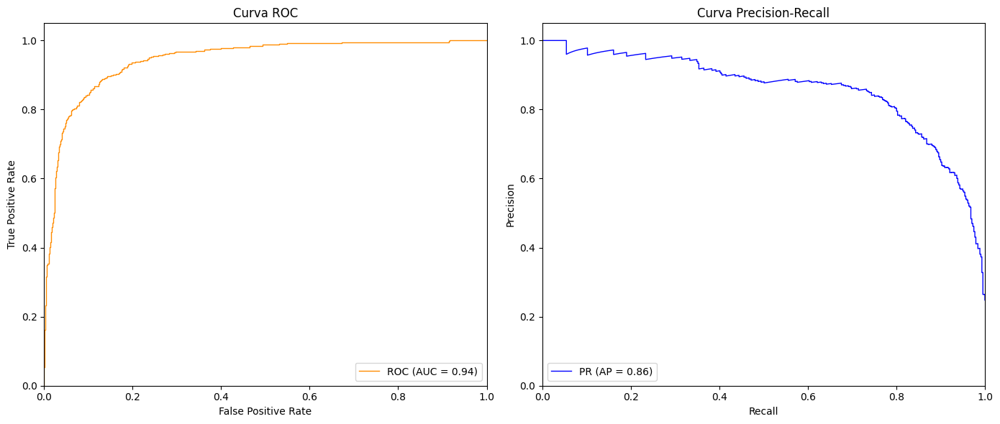

In [17]:
# ROC
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = roc_auc_score(y_test, y_proba)

# PR
precision, recall, _ = precision_recall_curve(y_test, y_proba)
pr_auc = average_precision_score(y_test, y_proba)

# Subplots
fig, axes = plt.subplots(1, 2, figsize=(14,6))

# Curva ROC
axes[0].plot(fpr, tpr, color='darkorange', lw=1, label=f'ROC (AUC = {roc_auc:.2f})')
axes[0].set_xlim([0.0, 1.0])
axes[0].set_ylim([0.0, 1.05])
axes[0].set_xlabel('False Positive Rate')
axes[0].set_ylabel('True Positive Rate')
axes[0].set_title('Curva ROC')
axes[0].legend(loc="lower right")

# Curva Precision-Recall
axes[1].plot(recall, precision, color='blue', lw=1, label=f'PR (AP = {pr_auc:.2f})')
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('Recall')
axes[1].set_ylabel('Precision')
axes[1].set_title('Curva Precision-Recall')
axes[1].legend(loc="lower left")

plt.tight_layout()
plt.show()


# 5. Conclusiones

* El análisis exploratorio permitió identificar un dataset con 9105 registros y 26 variables, incluyendo outliers y un claro desbalance en la variable objetivo, lo que justificó la necesidad de aplicar técnicas de escalamiento robusto y enfoques de modelado sensibles a la clase minoritaria.

* El pipeline desarrollado integró de forma ordenada el preprocesamiento (`RobustScaler` y `OneHotEncoder`), la reducción de dimensionalidad mediante PCA y el entrenamiento de un SVM con ajuste de `class_weight="balanced"`, logrando un flujo reproducible y eficiente para el problema.

* La búsqueda de hiperparámetros con `GridSearchCV` y validación cruzada permitió seleccionar un modelo óptimo con SVM lineal y 20 componentes principales en PCA, alcanzando un recall promedio de 0.8743 en validación cruzada. Aunque este resultado es alto, se reconoció el riesgo de sobreajuste, lo cual motivó la evaluación en el conjunto de prueba independiente.

* En la evaluación final, el modelo alcanzó un ROC-AUC de 0.94 y un PR-AUC de 0.86, confirmando una alta capacidad discriminativa en un contexto de datos desbalanceados. Se cumplió con el objetivo de maximizar el recall en la clase positiva (0.90), aunque con una precisión moderada (0.66) que refleja la presencia de falsos positivos.

* En términos generales, el modelo ofrece un equilibrio sólido entre sensibilidad y precisión, siendo apropiado para aplicaciones donde es más crítico detectar la mayor cantidad posible de casos positivos.